<a href="https://colab.research.google.com/github/tytinkdev/grad_work/blob/master/real_estate_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Seattle Housing Sales Price Report**

8.13.20

**Group 1 Analysts**  
_Prescriptive:_ Nick Ralston, Ty Tinker   
_Descriptive:_ Alex Glover, Roshni Singh   
_Predictive:_ Kent Campbell, Jack Yee  




## **Executive Summary**

**Business Problem Statement:**

> 


Our real estate company aims to predict the cash value of new houses entering the market using data collected on standard housing measurements. We examined internal (controllable) factors such as square footage of the living space, number of bedrooms and bathrooms, year built, and builders grade measurements. We also examined external (uncontrollable) factors such as traffic noise, zip code, square footage of the lot, and value of the lot. **Predicting the values of new houses entering the market allows us to discover properties with high value and investment potential.** Using this information we can make more informed strategic decisions which will drive our companies revenue and increase profits.


**Research Problem/Question:**


> 
Can we use standard housing measurements to help predict the cash value of a new house to enter the market?






**Target Feature:**
>
We were aimed at predicting the adjusted sales price of the house. Predicting this feature allows us to make more informed decisions when buying and selling properties.



**Recommended Action Items:**
>

*   Adjusted sales price is predicted to be the most influenced by the value of improvements, building grade and square footage to total living space. We can focus on these factors to identify  high value properties. We also found that the older the house, the lower the price, meaning that there is high value in investing in rennovations on older homes.
>
*   Land value is the best uncontrollable predictor of adjusted sales price and we can target houses with high land value for development. 
>
*   Bedrooms have diminishing marginal returns and we can shift our focus away from houses with over x bedrooms.



**Future Data Collection Recommendations:**

>

*   School District
*   Walk Score (How walkable is the area)
*   Parking
  *   Private/Public 
*   Garage
  *   Number of Cars

  




**Descriptive Analytics Questions and Answers:**
>
What effect does an increase in traffic noise have on the final adjusted sales price?
>
Is the zip code associated with mean sale price?
>
What variable is most correlated with sale price?
>
Are newer house on average more expensive than older houses?
>
What effect does increasing builder grade have on sales price?
>
Does adding a bedroom or bathroom add more value to the adjusted sales price?


**Predictive Analytics Questions and Answers**

How can we use variables such as size of living space in square feet, number of bathrooms, number of bedrooms, building grade, year built and improvement value to better predict the adjusted sales price of a house?
>Increasing the building grade rating by 1 level leads to an average increase of $62,644 and adding 1 SqFt TotLiving area to the property adds $60.97.

How can we use variables such as the square footage of the lot, traffic noise, land value and zip code to more accurately predict the adjusted sales price of a house?


> The square footage of the lot and land value each contribute about a dollar and half increase in valuation on average.  Traffic noise has a strong negative impact.Indented block






## **APPENDIX**

### Import Instructions: Read me first!

In [ ]:
#@title
#@Module import code
#import pandas modules
import pandas as pd
import numpy as np  
import seaborn as sns 
import matplotlib.pyplot as plt  
import matplotlib.pylab as mp
import matplotlib.ticker as mtick
from matplotlib.ticker import FormatStrFormatter
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import f_regression
from sklearn import metrics
from sklearn.metrics import r2_score
%matplotlib inline

# Code to read excel/sheets file into Colaboratory:
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
pip install folium

In order to access the data used in this report, you must import an .xlsx spreadsheet and several python modules.   
Please follow these steps before reading on:
1. Navigate to the drop down menu called 'Runtime' above
2. Click 'Run all'.  
3. Please click the link which appears beneath the cell above. This link will direct you to a Google verification page which will provide a code, similar to the one in the image below.  
4. Allow Google SDK to access your account.
5. When prompted, copy your unique code, then paste it in the box above. Press 'enter'.
6. After completing these steps, click the *Housing Sales Price Report* in the Table of contents sidebar on the left, and read on! 

In [ ]:
#@title
id = '181cjDj7JeoFSzo3ZPTYy7aCUeYXASflS'

#Import file by name and name a new variable 
downloaded = drive.CreateFile({'id':id}) 
downloaded.GetContentFile('house_sales_project.xlsx')  
house_sales = pd.read_excel('house_sales_project.xlsx')

## Remove Outliers


To enhance the predictive capability of the linear regression modeling, we decided to filter the data to remove outliers.  For this dataset, we assume normal distibution of data.  The following code calculates the mean and standard deviations. The data is then stardardized and outliers that are 3 standard deviations are flagged.  This is first applied to the AdjSalePrice.

In [ ]:
# Create variables to help find standardized AdjSalePrice
AdjSalePriceMean = round(house_sales['AdjSalePrice'].mean(),2)
AdjSalePriceStd = round(house_sales['AdjSalePrice'].std(),2 )

# Find standardized price
house_sales['AdjSalePriceNormal'] = (house_sales['AdjSalePrice'] - AdjSalePriceMean)/AdjSalePriceStd

# Determine potential outliers by testing standardized AdjSalePrice with +3 and -3 standard deviations
potOutliersAdjSPr = house_sales['AdjSalePriceNormal'].where((house_sales['AdjSalePriceNormal'] > 3) | (house_sales['AdjSalePriceNormal'] < -3)).dropna().sort_values()

# Create a Data Frame with only outliers
outlierDFAdjSPr = house_sales.where(house_sales['AdjSalePrice'].isin(potOutliersAdjSPr)).dropna(how = 'all')

NameError: ignored

Now, we apply the same approach to LandVal.

In [ ]:
# Create variables to help find standardized LandVal
LandValMean = round(house_sales['LandVal'].mean(),2)
LandValStd = round(house_sales['LandVal'].std(),2 )

# Find standardized LandVal
house_sales['LandValNormal'] = (house_sales['LandVal'] - LandValMean)/LandValStd

# Determine potential outliers by testing standardized LandVal with +3 and -3 standard deviations
potOutliersLandVal = house_sales['LandValNormal'].where((house_sales['LandValNormal'] > 3) | (house_sales['LandValNormal'] < -3)).dropna().sort_values()

# Create a Data Frame with only outliers
outlierDFLandVal = house_sales.where(house_sales['LandVal'].isin(potOutliersLandVal)).dropna(how = 'all')

Now, we apply this approach to ImpsVal.

In [ ]:
# Create variables to help find standardized ImpsVal
ImpsValMean = round(house_sales['ImpsVal'].mean(),2)
ImpsValStd = round(house_sales['ImpsVal'].std(),2 )

# Find standardized ImpsVal
house_sales['ImpsValNormal'] = (house_sales['ImpsVal'] - ImpsValMean)/ImpsValStd

# Determine potential outliers by testing standardized ImpsVal with +3 and -3 standard deviations
potOutliersImpsVal = house_sales['ImpsValNormal'].where((house_sales['ImpsValNormal'] > 3) | (house_sales['ImpsValNormal'] < -3)).dropna().sort_values()

# Create a Data Frame with only outliers
outlierDFImpsVal = house_sales.where(house_sales['ImpsVal'].isin(potOutliersImpsVal)).dropna(how = 'all')

Now, and again to SqFtLot.

In [ ]:
# Create variables to help find standardized SqFtLot
SqFtLotMean = round(house_sales['SqFtLot'].mean(),2)
SqFtLotStd = round(house_sales['SqFtLot'].std(),2 )

# Find standardized SqFtLot
house_sales['SqFtLotNormal'] = (house_sales['SqFtLot'] - SqFtLotMean)/SqFtLotStd

# Determine potential outliers by testing standardized SqFtLot with +3 and -3 standard deviations
potOutliersSqFtLot = house_sales['SqFtLotNormal'].where((house_sales['SqFtLotNormal'] > 3) | (house_sales['SqFtLotNormal'] < -3)).dropna().sort_values()

# Create a Data Frame with only outliers
outlierDFSqFtLot = house_sales.where(house_sales['SqFtLot'].isin(potOutliersSqFtLot)).dropna(how = 'all')

And, finally, to SqFTotLiving.

In [ ]:
# Create variables to help find standardized SqFtTotLiving
SqFtTotLivingMean = round(house_sales['SqFtTotLiving'].mean(),2)
SqFtTotLivingStd = round(house_sales['SqFtTotLiving'].std(),2 )

# Find standardized SqFtTotLiving
house_sales['SqFtTotLivingNormal'] = (house_sales['SqFtTotLiving'] - SqFtTotLivingMean)/SqFtTotLivingStd

# Determine potential outliers by testing standardized SqFtTotLiving with +3 and -3 standard deviations
potOutliersSqFtTotLiving = house_sales['SqFtTotLivingNormal'].where((house_sales['SqFtTotLivingNormal'] > 3) | (house_sales['SqFtTotLivingNormal'] < -3)).dropna().sort_values()

# Create a Data Frame with only outliers
outlierDFSqFtTotLiving = house_sales.where(house_sales['SqFtTotLiving'].isin(potOutliersSqFtTotLiving)).dropna(how = 'all')

The above outlier datasets are used to purge their occurrences in the full dataset.  

In [ ]:
# Create a Data Frame without outliers
house_sales_NO = house_sales.where(~house_sales['AdjSalePriceNormal'].isin(potOutliersAdjSPr)).dropna(how = 'all')
house_sales_NO = house_sales_NO.where(~house_sales['LandValNormal'].isin(potOutliersLandVal)).dropna(how = 'all')
house_sales_NO = house_sales_NO.where(~house_sales['ImpsValNormal'].isin(potOutliersImpsVal)).dropna(how = 'all')
house_sales_NO = house_sales_NO.where(~house_sales['SqFtLotNormal'].isin(potOutliersSqFtLot)).dropna(how = 'all')
house_sales_NO = house_sales_NO.where(~house_sales['SqFtTotLiving'].isin(potOutliersSqFtTotLiving)).dropna(how = 'all')

Additional 'hand editing' of the Bedrooms culls two extreme outliers of houses with 13 and 33 bedrooms.  Regressions noticeably improved with the removal of these two points.

In [ ]:
#Remove the high number bedrooms
potOutliersBedrooms = house_sales['Bedrooms'].where((house_sales['Bedrooms'] > 11)).dropna()
house_sales_NO = house_sales_NO.where(~house_sales['Bedrooms'].isin(potOutliersBedrooms)).dropna(how = 'all')

### Seattle Housing Prices Interactive Map

In [ ]:
house_sales_NO.to_csv('house_sales_NO.csv')

In [ ]:
house_sales_zip_agg = house_sales.groupby(['ZipCode']).AdjSalePrice.describe().sort_values(by='mean', ascending = False).round(4)
house_sales_zip_agg.to_csv('zipAgg')
zipAgg = pd.read_csv('zipAgg')
zipAgg['ZipCode']=zipAgg['ZipCode'].astype(str)
import folium

In [ ]:
#Create interactive house value map overlay
map = folium.Map(location=[47.4957, -121.7868], zoom_start= 10)
folium.Choropleth(geo_data="https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/wa_washington_zip_codes_geo.min.json",
             data=zipAgg, # my dataset
             columns=['ZipCode', 'mean'], # zip code is here for matching the geojson zipcode, sales price is the column that changes the color of zipcode areas
             key_on='feature.properties.ZCTA5CE10', # this path contains zipcodes in str type, this zipcodes should match with our ZIP CODE column
             fill_color='BuPu', fill_opacity=.6, line_weight=.8, line_opacity=0.8, nan_fill_opacity = 1,
             legend_name="Average House Value"
             ).add_to(map)
map

### **Descriptive Analytics Workflow**

In [ ]:
rows= house_sales_NO.shape[0]
columns = house_sales_NO.shape[1]
print('This data set has ' + str(rows) +' rows, and ' + str(columns) +' columns')

This data set has 21808 rows, and 18 columns


In [ ]:
#@title
max_bed = house_sales_NO.Bedrooms.max()
max_bath = house_sales_NO.Bathrooms.max()
max_price = house_sales_NO.AdjSalePrice.max()
max_sqft_lot = house_sales_NO.SqFtLot.max()
max_sqft_living = house_sales_NO.SqFtTotLiving.max()
max_tot_sqft= max_sqft_living+max_sqft_lot

print('The max sales price is: ' +str(max_price))
print('The max bedrooms are: ' + str(max_bed))
print('The max bathrooms are: ' +str(max_bath))
print('The max lot sqft is: ' +str(max_sqft_lot))
print('The max living sqft is: ' +str(max_sqft_living))
print('The max total sqft is: ' +str(max_tot_sqft))

The max sales price is: 1717895.0
The max bedrooms are: 11.0
The max bathrooms are: 8.0
The max lot sqft is: 98445.0
The max living sqft is: 7100.0
The max total sqft is: 105545.0


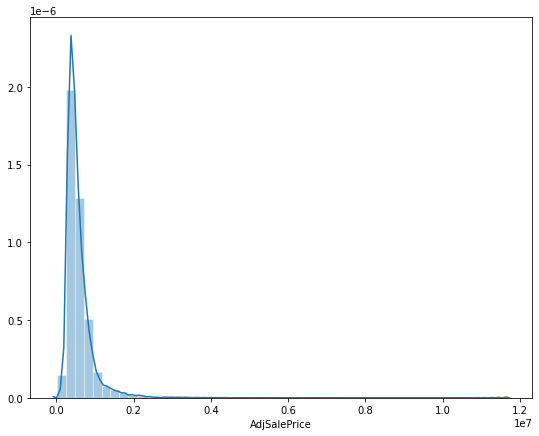

In [ ]:
plt.subplots(figsize=(9,7))
sns.set(font_scale = 1)
sns.distplot(house_sales['AdjSalePrice'])

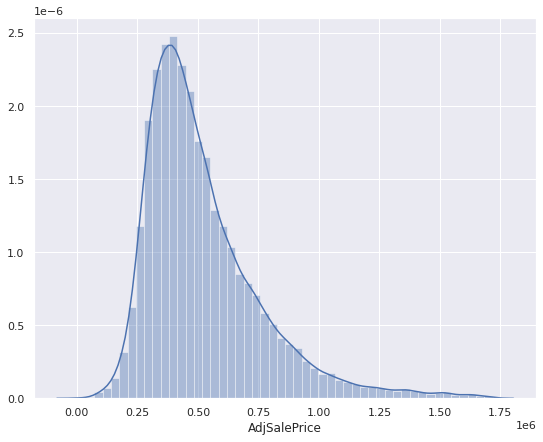

In [ ]:
#hist graph with outliers removed
plt.subplots(figsize=(9,7))
sns.set(font_scale = 1)
sns.distplot(house_sales_NO['AdjSalePrice'])

In [ ]:
#box plot of all variables?

AttributeError: ignored

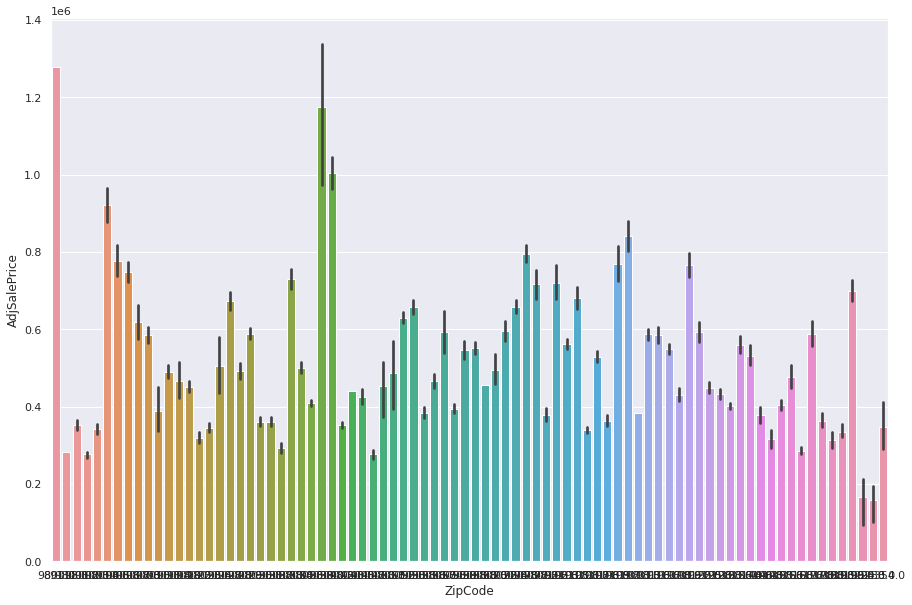

In [ ]:
plt.subplots(figsize=(15,10))
sns.set(font_scale = 2)
sns.barplot(x='ZipCode', y='AdjSalePrice', data=house_sales_NO)
plt.setp(house_sales_NO.get_xticklabels(), rotation=30, horizontalalignment='right')


In [ ]:

house_sales_NO.groupby(['YrBuilt']).AdjSalePrice.describe().sort_values(by= 'mean', ascending = False).round(4)

,count,mean,std,min,25%,50%,75%,max
YrBuilt,,,,,,,,
1901.0,25.0,667088.8800,307413.5799,278974.0,437895.00,574033.0,770094.00,1443629.0
1997.0,191.0,661774.5550,278283.6297,230975.0,463076.50,608842.0,779432.00,1529908.0
1904.0,59.0,660452.8136,304642.0378,281541.0,422862.50,598918.0,789392.50,1604455.0
1905.0,73.0,646369.0000,300033.9198,221016.0,443968.00,572315.0,752286.00,1520244.0
2005.0,614.0,619433.4756,281179.1190,187880.0,416798.75,537458.5,744346.00,1717895.0
...,...,...,...,...,...,...,...,...
1933.0,23.0,384595.6087,228912.7659,99379.0,221861.00,326529.0,517013.00,923415.0
1969.0,269.0,381082.1041,174819.6424,103154.0,256409.00,351656.0,446616.00,1316048.0
1944.0,144.0,378543.8750,138800.5262,147203.0,272129.75,351927.0,466016.50,877445.0


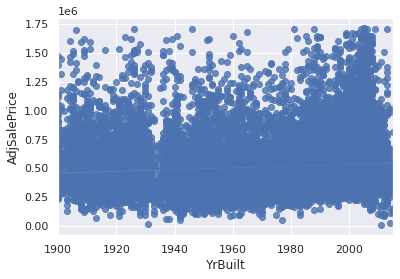

In [ ]:
sns.set(font_scale = 1)
sns.regplot(x='YrBuilt', y = 'AdjSalePrice', data=house_sales_NO)

In [ ]:
house_sales_NO.groupby(['NewConstruction']).AdjSalePrice.describe().sort_values(by='mean', ascending = False).round(4)

,count,mean,std,min,25%,50%,75%,max
NewConstruction,,,,,,,,
1.0,2337.0,573788.3436,239801.3410,95799.0,400633.0,496458.0,703528.0,1717895.0
0.0,19471.0,514731.8821,237965.0206,3368.0,350234.5,458264.0,616675.0,1716953.0


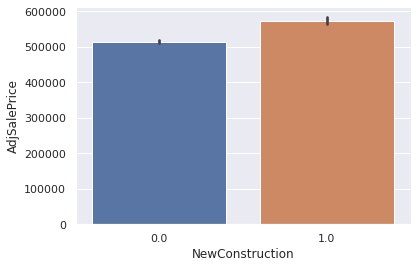

In [ ]:
sns.set(font_scale = 1)
sns.barplot(x='NewConstruction', y='AdjSalePrice', data=house_sales_NO)

In [ ]:
house_sales_NO.groupby(['BldgGrade']).AdjSalePrice.describe().sort_values(by='mean', ascending=False).round(4)

,count,mean,std,min,25%,50%,75%,max
BldgGrade,,,,,,,,
13.0,2.0,1.576765e+06,71246.6651,1526386.0,1551575.50,1576765.0,1601954.50,1627144.0
12.0,16.0,1.401616e+06,189344.7314,1084986.0,1271684.50,1396908.0,1566422.75,1651909.0
11.0,252.0,1.185555e+06,249829.7023,277787.0,1009510.75,1153373.0,1370184.25,1716953.0
10.0,1006.0,9.310972e+05,262748.1884,146311.0,762643.50,898518.5,1054585.50,1717895.0
9.0,2661.0,7.575879e+05,235467.8285,104333.0,605425.00,723164.0,860860.00,1705428.0
8.0,6159.0,5.543556e+05,175893.4218,23980.0,431400.00,526890.0,640951.00,1637629.0
7.0,9406.0,4.193273e+05,127579.6180,3368.0,330331.75,400050.0,486844.25,1355160.0
6.0,2095.0,3.209937e+05,97343.0870,11632.0,256092.00,310889.0,377373.00,983816.0
5.0,198.0,2.649886e+05,83844.7213,54373.0,217650.75,256888.0,311248.75,542099.0


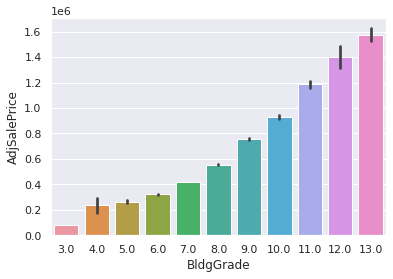

In [ ]:
sns.set(font_scale = 1)
sns.barplot(x='BldgGrade', y='AdjSalePrice', data=house_sales_NO)

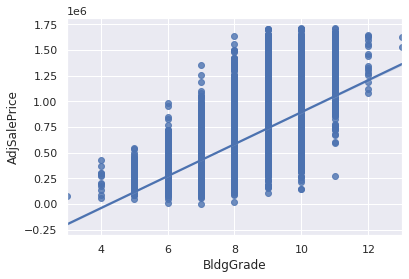

In [ ]:
sns.set(font_scale = 1)
sns.regplot(x='BldgGrade', y= 'AdjSalePrice', data=house_sales_NO)

In [ ]:
house_sales_NO.groupby(['Bedrooms']).AdjSalePrice.describe().sort_values(by='mean', ascending=False).round(4)

,count,mean,std,min,25%,50%,75%,max
Bedrooms,,,,,,,,
8.0,8.0,772784.6250,316305.0032,326993.0,589856.75,757235.0,852662.75,1394872.0
5.0,1311.0,660043.9497,304552.0650,83055.0,431804.50,597333.0,806118.50,1710368.0
7.0,34.0,638275.0294,286830.6273,210434.0,448792.00,582950.0,781369.75,1678403.0
6.0,213.0,636202.9390,302543.7360,114213.0,419004.00,566731.0,797193.00,1587339.0
4.0,7210.0,608079.7699,261774.7974,23980.0,415948.50,548802.0,742651.00,1717895.0
9.0,4.0,573621.0000,136692.1100,442754.0,508642.25,543191.0,608169.75,765348.0
3.0,9969.0,472291.9131,196336.3975,3368.0,337915.00,429474.0,555777.00,1707922.0
11.0,2.0,468728.0000,36162.8550,443157.0,455942.50,468728.0,481513.50,494299.0
2.0,2894.0,409258.6866,155947.3357,85269.0,306728.75,387416.0,477977.50,1580679.0


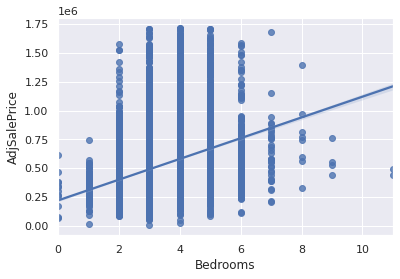

In [ ]:
sns.regplot(x='Bedrooms', y ='AdjSalePrice', data= house_sales_NO)

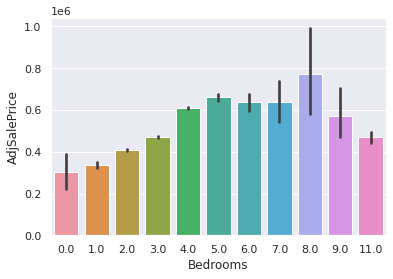

In [ ]:
sns.set(font_scale = 1)
sns.barplot(x='Bedrooms', y='AdjSalePrice', data=house_sales_NO)

In [ ]:
house_sales_NO.groupby(['Bathrooms']).AdjSalePrice.describe().sort_values(by='mean', ascending=False).round(4)

,count,mean,std,min,25%,50%,75%,max
Bathrooms,,,,,,,,
5.50,2.0,1.360678e+06,295335.1680,1151845.0,1256261.75,1360678.5,1465095.25,1569512.0
4.25,56.0,1.025365e+06,367845.1041,272553.0,806047.00,1045744.5,1274280.25,1704843.0
5.25,9.0,1.024620e+06,392492.8309,364693.0,936952.00,994029.0,1134431.00,1564117.0
4.50,54.0,1.004741e+06,375521.1499,268454.0,672505.75,1097460.5,1228148.50,1636090.0
4.00,92.0,9.120361e+05,380054.0770,230292.0,595845.25,910215.5,1220437.50,1670776.0
3.75,142.0,9.038128e+05,358403.6242,182533.0,627001.00,900784.5,1154423.00,1710368.0
6.00,4.0,9.023042e+05,356963.1752,565328.0,696991.25,824508.5,1029821.50,1394872.0
4.75,12.0,8.664478e+05,202451.1367,583657.0,755734.75,820169.5,1026672.00,1201876.0
3.50,773.0,8.384841e+05,320638.9284,146311.0,604254.00,808393.0,998873.00,1717895.0


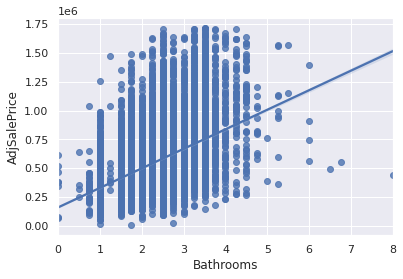

In [ ]:
sns.regplot(x='Bathrooms', y='AdjSalePrice', data= house_sales_NO)

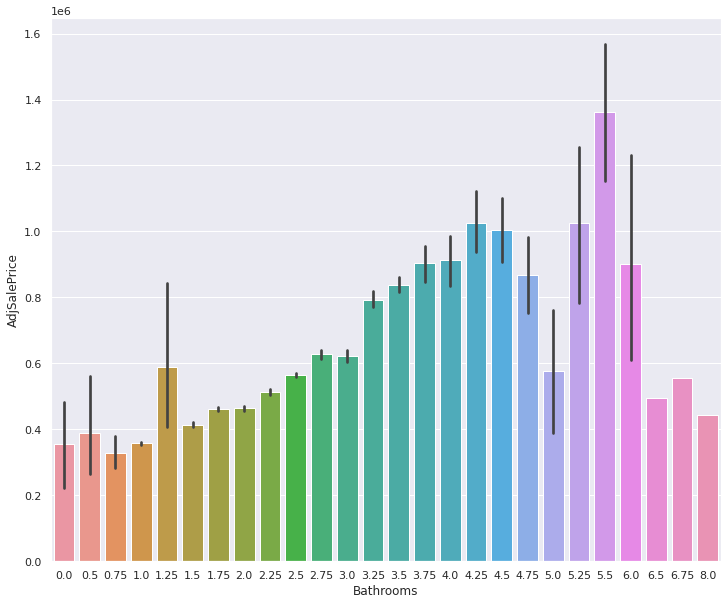

In [ ]:
sns.set(font_scale = 1)
plt.subplots(figsize=(12,10))
sns.barplot(x='Bathrooms', y='AdjSalePrice', data=house_sales_NO)

In [ ]:
house_sales_NO.groupby(['TrafficNoise']).AdjSalePrice.describe().sort_values(by='mean', ascending=False).round(4)

,count,mean,std,min,25%,50%,75%,max
TrafficNoise,,,,,,,,
0.0,18739.0,522443.2771,239070.2838,3368.0,356721.00,463607.0,628469.50,1717895.0
1.0,1804.0,520279.6486,240692.3017,85269.0,356638.75,461252.5,625233.75,1670187.0
3.0,157.0,510851.7707,239057.8906,90735.0,360404.00,480141.0,603682.00,1705443.0
2.0,1108.0,500392.6471,231419.1666,54373.0,349300.00,448728.5,592591.00,1707922.0


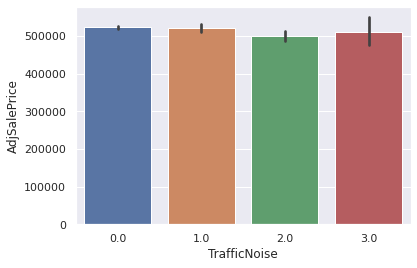

In [ ]:
sns.set(font_scale = 1)
sns.barplot(x='TrafficNoise', y='AdjSalePrice', data=house_sales_NO)

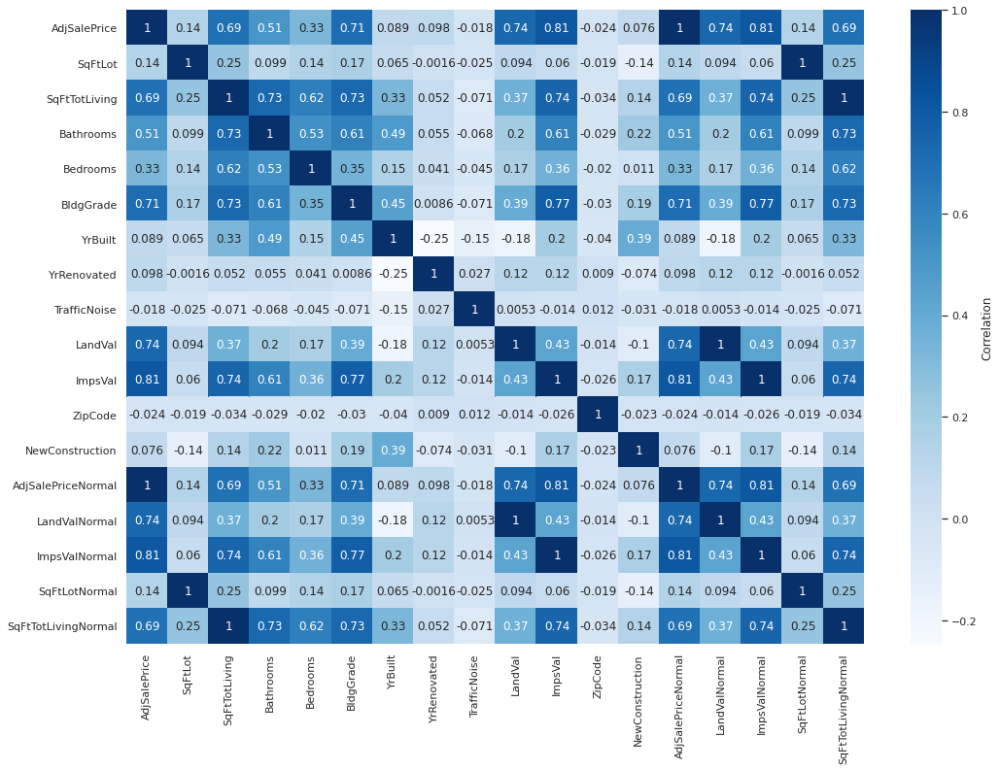

In [ ]:
plt.subplots(figsize=(17,12))
sns.set(font_scale = 1)
sns.heatmap(house_sales_NO.corr(), annot= True, cmap= 'Blues', cbar_kws={'label': 'Correlation'})

## **Predictive Analytics Workflow**

## Predictive Analytics Tutorials

The following workflow and tutorial outlines how to run a linear regression using Python.


## Predictive Analytics Using Linear Regression Modeling of Controllable Variables


### Step 1.

Create an X array that contains the independent features to train the model (SqFtTotLiving, Bathrooms, Bedrooms, BldgGrade, YrBuilt, ImpsVal) and a y array with the target or dependent variable (AdjSalePrice).


In [ ]:
X = house_sales_NO[['SqFtTotLiving', 'Bathrooms', 'Bedrooms', 'BldgGrade', 'YrBuilt', 'ImpsVal']]
y = house_sales_NO['AdjSalePrice']

### Step 2.

Split the housing dataset into training and testing datasets.  Using 0.40 splits the data into 60%/40% traing and testing. 

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.4, random_state=101)

### Step 3.

Create a linear regression object/variable from the imported sklearn module and train the model with X (independent) and y (dependent) datas.

In [ ]:
lm = LinearRegression()
lm.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

### Step 4.

Now, we can evaluate the linear regression model's intercept, 'alpha'.

In [ ]:
lm.intercept_

2917259.2739166557

And the model coefficients for each independent variable, the 'beta's'.



In [ ]:
coeff = lm.coef_
coeff

array([ 6.16453325e+01,  4.87381004e+03, -1.57491336e+04,  6.42895020e+04,
       -1.60824803e+03,  7.32232292e-01])

Create a DataFrame to more easily intepret the coefficients with column labels from our X variables.

In [ ]:
coeff_df = pd.DataFrame(lm.coef_, X.columns, columns=['Coeff'])
coeff_df

,Coeff
SqFtTotLiving,61.645332
Bathrooms,4873.810036
Bedrooms,-15749.133617
BldgGrade,64289.502019
YrBuilt,-1608.248034
ImpsVal,0.732232


### **Interpreting the coefficients:**

-  Holding all other features fixed, a 1 unit (1sqft) increase in SqFtTotLiving is associated with an increase of $61.65.

  - **1,000sqft increase in living space is associated with an average AdjSalePrice increase of $616,453.20**

-  Holding all other features fixed, a 1 unit increase in Bathrooms is associated with an increase of $4,873.81.

-  Holding all other features fixed, a 1 unit increase in Bedrooms is associated with a decrease of $15,749.13.

-  Holding all other features fixed, a 1 unit increase in BuildingGrade is associated with an increase of $64,289.50 .

-  Holding all other features fixed, a 1 unit increase in YrBuilt is associated with a decrease of $1,608.25.

-  Holding all other features fixed, a 1 unit increase in ImpsVal is associated with an increase of $0.73.

### Step 5.

To better understand the features of the linear regression modeling, let's revisit the independent valiables.

In [ ]:
features = pd.Series(X_train.columns)
features

0    SqFtTotLiving
1        Bathrooms
2         Bedrooms
3        BldgGrade
4          YrBuilt
5          ImpsVal
dtype: object

For additional insight into the modeling, use f_regression to calculate F-statistics (t-stats) and p-values for our features.  More details can be found at https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_regression.html

In [ ]:
f_regression(X_train, y_train)

(array([11146.19288343,  4488.76280018,  1536.70017321, 12990.95846378,
          104.79580427, 23552.18338585]),
 array([0.00000000e+000, 0.00000000e+000, 6.75867476e-318, 0.00000000e+000,
        1.67488786e-024, 0.00000000e+000]))

Create variables to store the F-stats and p-values in their own lists.

In [ ]:
fstats = f_regression(X_train, y_train)[0]
pvalues = f_regression(X_train, y_train)[1]

Create a feature dataframe to interpret the features by relative importance.



In [ ]:
featureDF = pd.DataFrame({'Features': features, 'Coeff': coeff, 'Fstats': fstats, 'P Value':pvalues})
featureDF.sort_values(by=['Fstats'], ascending=False)

,Features,Coeff,Fstats,P Value
5,ImpsVal,0.732232,23552.183386,0.000000e+00
3,BldgGrade,64289.502019,12990.958464,0.000000e+00
0,SqFtTotLiving,61.645332,11146.192883,0.000000e+00
1,Bathrooms,4873.810036,4488.762800,0.000000e+00
2,Bedrooms,-15749.133617,1536.700173,6.758675e-318
4,YrBuilt,-1608.248034,104.795804,1.674888e-24


### Step 6.

Now, create predictions from the linear regression modeling using the test dataset.



In [ ]:
predictions = lm.predict(X_test)
predictions

array([281216.74446107, 246523.1563014 , 322404.64894856, ...,
       356121.7458171 , 712194.2896467 , 591799.8101297 ])

How well did the model perform?  Graphically, you can evaluate the model by plotting y_test vs predictions.

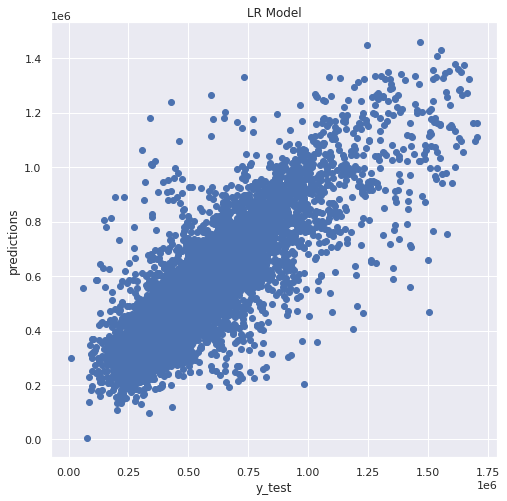

In [ ]:
plt.figure(figsize=(8,8))
plt.scatter(y_test, predictions)
plt.title("LR Model")
plt.xlabel("y_test")
plt.ylabel("predictions")
plt.show()

But, let's calculate the residuals, the difference between the actual and the predicted values and show the top 5 largest residuals.

In [ ]:
residuals = y_test - predictions
residuals.nlargest()

5010     1.036547e+06
17399    8.667008e+05
15864    8.409477e+05
12505    8.257098e+05
4141     7.810730e+05
Name: AdjSalePrice, dtype: float64

Plotting these show the distribution of the residuals.

Text(0, 0.5, 'AdjSalePric residual')

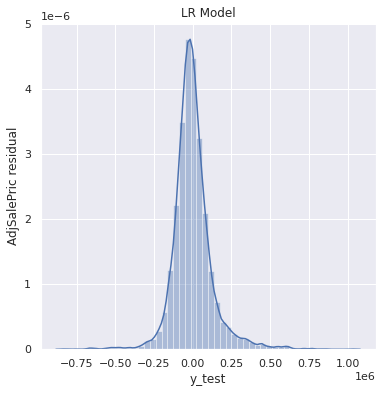

In [ ]:
plt.figure(figsize=(6,6))
sns.distplot(residuals, bins= 50)
plt.title("LR Model")
plt.xlabel("y_test")
plt.ylabel("AdjSalePric residual")

Looking at a small sampling, you can see how well the modeling performs at the individual level.

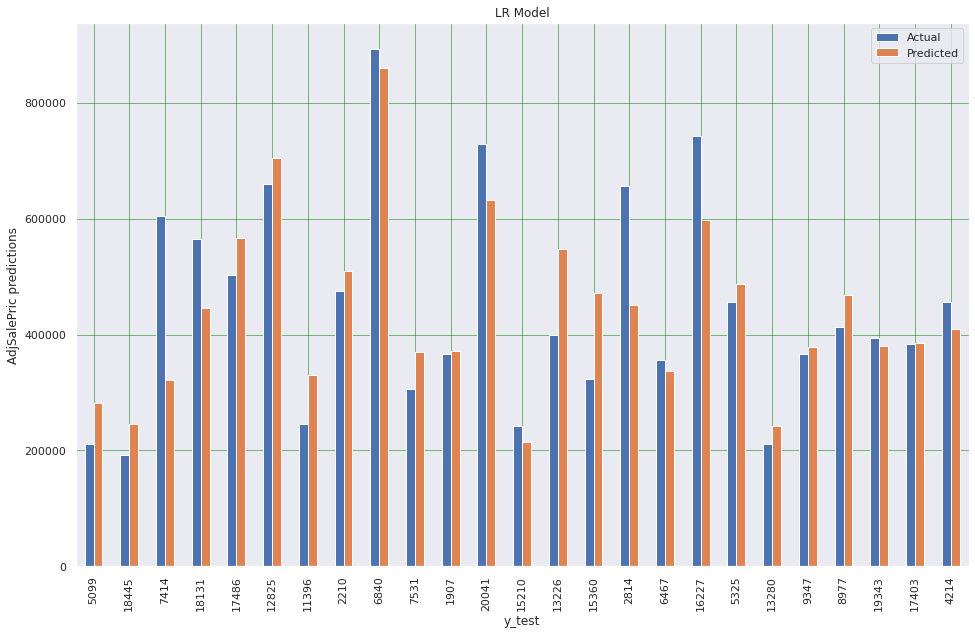

In [ ]:
dfX = pd.DataFrame({'Actual': y_test, 'Predicted': predictions.flatten()})
dfXhead = dfX.head(25)
dfXhead.plot(kind='bar',figsize=(16,10))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title("LR Model")
plt.xlabel("y_test")
plt.ylabel("AdjSalePric predictions")
plt.show()

### Step 7.

**Regression Evaluation Metrics**

Here are three common evaluation metrics for regression problems:

**Mean Absolute Error (MAE)** is the mean of the absolute value of the errors:
1𝑛∑𝑖=1𝑛|𝑦𝑖−𝑦̂𝑖|
1
n
∑
i
=
1
n
|
y
i
−
y
^
i
|
 
**Mean Squared Error (MSE)** is the mean of the squared errors:
1𝑛∑𝑖=1𝑛(𝑦𝑖−𝑦̂𝑖)2
1
n
∑
i
=
1
n
(
y
i
−
y
^
i
)
2
 
**Root Mean Squared Error (RMSE)** is the square root of the mean of the squared errors (MSE):
1𝑛∑𝑖=1𝑛(𝑦𝑖−𝑦̂𝑖)2⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯⎯
1
n
∑
i
=
1
n
(
y
i
−
y
^
i
)
2
 
Comparing these metrics:

*MAE* is the easiest to understand, because it's the average error.

*MSE* is more popular than MAE, because MSE "punishes" larger errors, which tends to be useful in the real world.

*RMSE* is even more popular than MSE, because RMSE is interpretable in the target variable (y) units.

All of these are *loss functions*, because we want to minimize them.

Calculate the MAE, MSE, RMSE, and R^2 scores:

In [ ]:
print('MAE: ', round(metrics.mean_absolute_error(y_test, predictions), 2))
print('MSE: ', round(metrics.mean_squared_error(y_test, predictions), 2))
print('RMSE: ', round(np.sqrt(metrics.mean_squared_error(y_test, predictions)), 2))
print('R Square: ', round(r2_score(y_test, predictions), 3))

MAE:  86911.47
MSE:  16797480355.97
RMSE:  129605.09
R Square:  0.712


## **Predictive Analytics Using Linear Regression for Uncontrollable Variables**

### Step 1.

Create an X array that contains the independent features to train the model (SqFtLot, Traffic Noise, and LandVal) and a y array with the target or dependent variable (AdjSalePrice).

In [ ]:
X2 = house_sales_NO[['SqFtLot', 'TrafficNoise', 'LandVal']]
y2 = house_sales_NO['AdjSalePrice']

 ### Step 2.


Split the housing dataset into training and testing datasets.  Using 0.40 splits the data into 60%/40% traing and testing. 

In [ ]:
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=.4, random_state=101)

### Step 3.

Create a linear regression object/variable.

In [ ]:
lm2 = LinearRegression()

Train the model with X (independent) and y (dependent) datas.

In [ ]:
lm2.fit(X2_train, y2_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

### Step 4.

Now, we can evaluate the linear regression model's intercept, 'alpha'.

In [ ]:
lm2.intercept_

223869.43730060523

And the model coefficients for each independent variable, the 'beta's'.

In [ ]:
coeff2 = lm2.coef_

coeff2

array([ 1.62596295e+00, -9.78376271e+03,  1.41375851e+00])

Create a DataFrame to more easily intepret the coefficients with column labels from our X variables.

In [ ]:
coeff_df2 = pd.DataFrame(lm2.coef_, X2.columns, columns=['Coeff'])
coeff_df2

,Coeff
SqFtLot,1.625963
TrafficNoise,-9783.762712
LandVal,1.413759


### **Interpreting the coefficients:**

-  Holding all other features fixed, a 1 unit (1sqft) increase in SqFtTotLot is associated with an increase of $1.63.

  - **1,000sqft increase in living space is associated with an average AdjSalePrice increase of $1,625.96.**

-  Holding all other features fixed, a 1 unit increase in Traffic Noise is associated with a strong decrease of -$9,783.76.

-  Holding all other features fixed, a 1 unit increase in LandVal is associated with an increase of $1.41.

### Step 5.

To better understand the features of the linear regression modeling, let's revisit the independent valiables.

In [ ]:
features2 = pd.Series(X2_train.columns)
features2

0         SqFtLot
1    TrafficNoise
2         LandVal
dtype: object

For additional insight into the modeling, use f_regression to calculate F-statistics (t-stats) and p-values for our features.  More details can be found at https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_regression.html

In [ ]:
f_regression(X2_train, y2_train)

(array([2.45050629e+02, 7.53600422e+00, 1.53632117e+04]),
 array([9.76686683e-55, 6.05605743e-03, 0.00000000e+00]))

Create variables to store the F-stats and p-values in their own lists.

In [ ]:
fstats2 = f_regression(X2_train, y2_train)[0]
pvalues2 = f_regression(X2_train, y2_train)[1]

Create a feature dataframe to interpret the features by relative importance.

In [ ]:
featureDF2 = pd.DataFrame({'Features': features2, 'Coeff': coeff2, 'Fstats': fstats2, 'P Value':pvalues2})
featureDF2.sort_values(by=['Fstats'], ascending=False)

,Features,Coeff,Fstats,P Value
2,LandVal,1.413759,15363.211735,0.000000e+00
0,SqFtLot,1.625963,245.050629,9.766867e-55
1,TrafficNoise,-9783.762712,7.536004,6.056057e-03


### Step 6.

Now, create predictions from the linear regression modeling using the test dataset.

In [ ]:
predictions2 = lm2.predict(X2_test)
predictions2

array([ 321736.82902605,  353794.68795713, 1028157.49488867, ...,
        529718.6085117 ,  605572.12037126,  505291.19832361])

How well did the model perform? Graphically, you can evaluate the model by plotting y_test vs predictions.

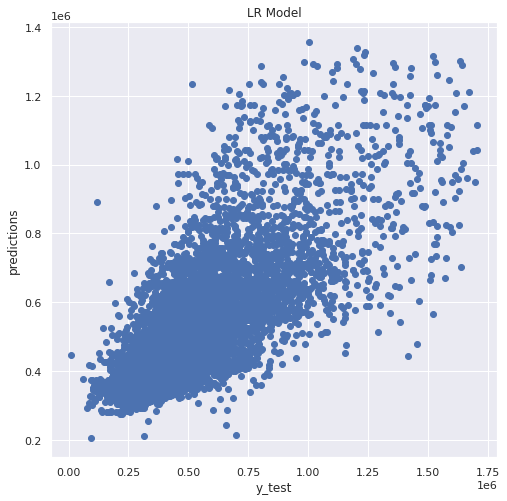

In [ ]:
plt.figure(figsize=(8,8))
plt.scatter(y2_test, predictions2)
plt.title("LR Model")
plt.xlabel("y_test")
plt.ylabel("predictions")
plt.show()

But, let's calculate the residuals, the difference between the actual and the predicted values and show the top 5 largest residuals.

In [ ]:
residuals2 = y2_test - predictions2
residuals2.nlargest()


20680    976800.016682
11439    973477.128406
19482    952999.442796
8040     935052.571008
20744    899356.012336
Name: AdjSalePrice, dtype: float64

Plotting these show the distribution of the residuals.

Text(0, 0.5, 'AdjSalePrice Residual')

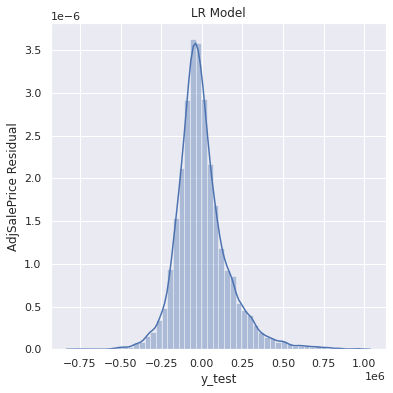

In [ ]:
plt.figure(figsize=(6,6))
sns.distplot(residuals2, bins= 50)
plt.title("LR Model")
plt.xlabel("y_test")
plt.ylabel("AdjSalePrice Residual")

Looking at a small sampling, you can see how well the modeling performs at the individual level.

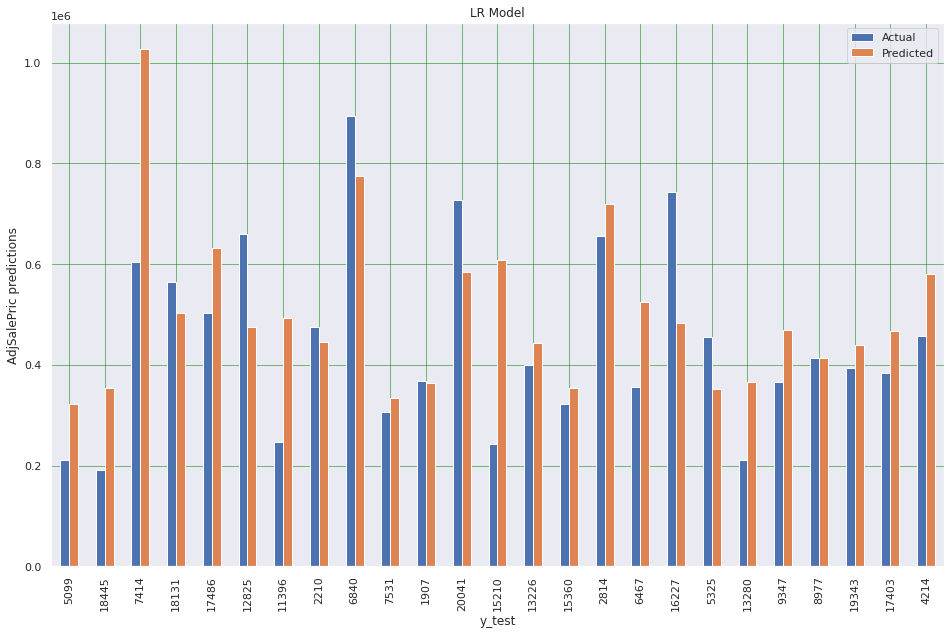

In [ ]:
dfX2 = pd.DataFrame({'Actual': y2_test, 'Predicted': predictions2.flatten()})
dfX2head = dfX2.head(25)
dfX2head.plot(kind='bar',figsize=(16,10))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title("LR Model")
plt.xlabel("y_test")
plt.ylabel("AdjSalePric predictions")
plt.show()

### Step 7.

And, finally, calculate the MAE, MSE, RMSE, and R^2 scores.

In [ ]:
print('MAE: ', round(metrics.mean_absolute_error(y2_test, predictions2), 2))
print('MSE: ', round(metrics.mean_squared_error(y2_test, predictions2), 2))
print('RMSE: ', round(np.sqrt(metrics.mean_squared_error(y2_test, predictions2)), 2))
print('R Square: ', round(r2_score(y2_test, predictions2), 3))

MAE:  116273.96
MSE:  26253506000.58
RMSE:  162029.34
R Square:  0.55


## Question Tree

![](https://drive.google.com/uc?export=view&id=1FJqmRQcG61N2pqDWkGX-f-urlLkISq2M)